# Weather events

In [2]:
import kagglehub
import os
import pandas as pd
# Download latest version
path = kagglehub.dataset_download("sobhanmoosavi/us-weather-events")

print("Path to dataset files:", path)
os.listdir(path)
df_weather_events=pd.read_csv(path+'/WeatherEvents_Jan2016-Dec2022.csv')
df_weather_events.head()


[notice] A new release of pip is available: 24.2 -> 24.3.1
[notice] To update, run: C:\Users\lucas\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


100%|██████████| 92.6M/92.6M [00:04<00:00, 20.5MB/s]

Extracting files...


Path to dataset files: C:\Users\lucas\.cache\kagglehub\datasets\sobhanmoosavi\us-weather-events\versions\4


,EventId,Type,Severity,StartTime(UTC),EndTime(UTC),Precipitation(in),TimeZone,AirportCode,LocationLat,LocationLng,City,County,State,ZipCode
0,W-1,Snow,Light,2016-01-06 23:14:00,2016-01-07 00:34:00,0.00,US/Mountain,K04V,38.0972,-106.1689,Saguache,Saguache,CO,81149.0
1,W-2,Snow,Light,2016-01-07 04:14:00,2016-01-07 04:54:00,0.00,US/Mountain,K04V,38.0972,-106.1689,Saguache,Saguache,CO,81149.0
2,W-3,Snow,Light,2016-01-07 05:54:00,2016-01-07 15:34:00,0.03,US/Mountain,K04V,38.0972,-106.1689,Saguache,Saguache,CO,81149.0
3,W-4,Snow,Light,2016-01-08 05:34:00,2016-01-08 05:54:00,0.00,US/Mountain,K04V,38.0972,-106.1689,Saguache,Saguache,CO,81149.0
4,W-5,Snow,Light,2016-01-08 13:54:00,2016-01-08 15:54:00,0.00,US/Mountain,K04V,38.0972,-106.1689,Saguache,Saguache,CO,81149.0


In [3]:
df_weather_events.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8627181 entries, 0 to 8627180
Data columns (total 14 columns):
 #   Column             Dtype  
---  ------             -----  
 0   EventId            object 
 1   Type               object 
 2   Severity           object 
 3   StartTime(UTC)     object 
 4   EndTime(UTC)       object 
 5   Precipitation(in)  float64
 6   TimeZone           object 
 7   AirportCode        object 
 8   LocationLat        float64
 9   LocationLng        float64
 10  City               object 
 11  County             object 
 12  State              object 
 13  ZipCode            float64
dtypes: float64(4), object(10)
memory usage: 921.5+ MB


In [4]:
print(df_weather_events.Severity.unique())
print(df_weather_events.Type.unique())


['Light' 'Severe' 'Moderate' 'Heavy' 'UNK' 'Other']
['Snow' 'Fog' 'Cold' 'Storm' 'Rain' 'Precipitation' 'Hail']


In [5]:
print(df_weather_events.Type.unique())
df_weather_events_by_state=df_weather_events.groupby(["State","Type","Severity" ]).size().to_frame('size')
df_weather_events_by_state.head(10)

['Snow' 'Fog' 'Cold' 'Storm' 'Rain' 'Precipitation' 'Hail']


size
State Type          Severity        
AL    Cold          Severe      5587
      Fog           Moderate    8317
                    Severe     35365
      Hail          Other         47
      Precipitation UNK         6264
      Rain          Heavy       8271
                    Light     107770
                    Moderate   23987
      Snow          Heavy        108
                    Light       1151

In [7]:
import plotly.graph_objects as go
# global
type="Global"
df_weather_plot=df_weather_events

# By type
#type="Snow"
#type="Rain"
#type="Precipitation"
#type="Storm"
#df_weather_plot=df_weather_events[df_weather_events["Type"]==type]

# By severity
#type="Severe"
#df_weather_plot=df_weather_events[df_weather_events["Severity"]==type]


fig = go.Figure(
    data=go.Choropleth(
        locations = pd.value_counts(df_weather_plot['State']).index,
        z = pd.value_counts(df_weather_plot['State']).values.astype(float),
        locationmode = 'USA-states',
        colorscale = 'SunsetDark',
        colorbar_title = "size"),
    layout=go.Layout(
        title_text='US weather events for '+ type,
        title_x=0.5,
        font=dict(family='Verdana', size=12, color='#000000'),
        geo_scope='usa'))

fig.show()


[notice] A new release of pip is available: 24.2 -> 24.3.1
[notice] To update, run: C:\Users\lucas\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


   ---------------------------------------- 0.0/19.1 MB ? eta -:--:--
   --------- ------------------------------ 4.7/19.1 MB 25.9 MB/s eta 0:00:01
   -------------------- ------------------- 9.7/19.1 MB 24.1 MB/s eta 0:00:01
   ------------------------------ --------- 14.7/19.1 MB 24.3 MB/s eta 0:00:01
   ---------------------------------------  18.9/19.1 MB 23.4 MB/s eta 0:00:01
   ---------------------------------------- 19.1/19.1 MB 21.5 MB/s eta 0:00:00


C:\Users\lucas\AppData\Local\Temp\ipykernel_9880\148533345.py:21: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  locations = pd.value_counts(df_weather_plot['State']).index,
C:\Users\lucas\AppData\Local\Temp\ipykernel_9880\148533345.py:22: FutureWarning: pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.
  z = pd.value_counts(df_weather_plot['State']).values.astype(float),


In [8]:
group_type='State'

df_weather_cluster = df_weather_events[(df_weather_events['Severity'] != 'UNK') & (df_weather_events['Severity'] != 'Other')]
df_weather_cluster = df_weather_events[[group_type,'Type']]
df_weather_cluster.head()
types = pd.get_dummies(df_weather_cluster['Type'])

types[group_type] = df_weather_cluster[group_type]

types = types.groupby(group_type).sum().reset_index()
df_weather_cluster=types
df_weather_cluster.head()

,State,Cold,Fog,Hail,Precipitation,Rain,Snow,Storm
0,AL,5587,43682,47,6264,140028,1440,131
1,AR,3552,39362,12,6226,105919,3683,173
2,AZ,3879,12191,21,723,38445,8402,1029
3,CA,14300,173552,32,2109,144740,14175,2752
4,CO,6251,32754,104,967,80506,64683,8274


In [9]:
from sklearn.cluster import KMeans
group = df_weather_cluster[[group_type]]
df_weather_cluster.drop(group_type, axis=1, inplace=True)

# run k-means clustering
kmeans = KMeans(n_clusters=6, random_state=0).fit(types)

group['cluster'] = kmeans.labels_
group.head()

C:\Users\lucas\AppData\Local\Temp\ipykernel_9880\3574801613.py:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,State,cluster
0,AL,2
1,AR,0
2,AZ,3
3,CA,5
4,CO,0


In [10]:

fig = go.Figure(
    data=go.Choropleth(
        locations = pd.value_counts(group[group_type]).index,
        z = group['cluster'],
        locationmode = 'USA-states',
        colorscale = 'SunsetDark',
        colorbar_title = "size"),
    layout=go.Layout(
        title_text='US types of climate per state ',
        title_x=0.5,
        font=dict(family='Verdana', size=12, color='#000000'),
        geo_scope='usa'))

fig.show()

C:\Users\lucas\AppData\Local\Temp\ipykernel_9880\4153240362.py:3: FutureWarning:

pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.



# US Accidents

In [11]:
df_weather_events.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8627181 entries, 0 to 8627180
Data columns (total 14 columns):
 #   Column             Dtype  
---  ------             -----  
 0   EventId            object 
 1   Type               object 
 2   Severity           object 
 3   StartTime(UTC)     object 
 4   EndTime(UTC)       object 
 5   Precipitation(in)  float64
 6   TimeZone           object 
 7   AirportCode        object 
 8   LocationLat        float64
 9   LocationLng        float64
 10  City               object 
 11  County             object 
 12  State              object 
 13  ZipCode            float64
dtypes: float64(4), object(10)
memory usage: 921.5+ MB


In [12]:
import kagglehub
import os

# Download latest version
path = kagglehub.dataset_download("sobhanmoosavi/us-accidents")

print("Path to dataset files:", path)
os.listdir(path)


100%|██████████| 653M/653M [00:30<00:00, 22.5MB/s] 

Extracting files...


Path to dataset files: C:\Users\lucas\.cache\kagglehub\datasets\sobhanmoosavi\us-accidents\versions\13


['US_Accidents_March23.csv']

In [13]:
import pandas as pd
#df_accidents=pd.read_csv("US_Accidents_March23.csv", nrows=100)
# the dataset is too big to fit in colab memory (12Gb) => only read the first n lines
df_accidents=pd.read_csv(path+'/US_Accidents_March23.csv')
df_accidents['Start_Year'] = df_accidents['Start_Time'].apply(lambda x: x[:4]).astype('category')
df_accidents.head()

,ID,Source,Severity,Start_Time,End_Time,Start_Lat,Start_Lng,End_Lat,End_Lng,Distance(mi),...,Station,Stop,Traffic_Calming,Traffic_Signal,Turning_Loop,Sunrise_Sunset,Civil_Twilight,Nautical_Twilight,Astronomical_Twilight,Start_Year
0,A-1,Source2,3,2016-02-08 05:46:00,2016-02-08 11:00:00,39.865147,-84.058723,NaN,NaN,0.01,...,False,False,False,False,False,Night,Night,Night,Night,2016
1,A-2,Source2,2,2016-02-08 06:07:59,2016-02-08 06:37:59,39.928059,-82.831184,NaN,NaN,0.01,...,False,False,False,False,False,Night,Night,Night,Day,2016
2,A-3,Source2,2,2016-02-08 06:49:27,2016-02-08 07:19:27,39.063148,-84.032608,NaN,NaN,0.01,...,False,False,False,True,False,Night,Night,Day,Day,2016
3,A-4,Source2,3,2016-02-08 07:23:34,2016-02-08 07:53:34,39.747753,-84.205582,NaN,NaN,0.01,...,False,False,False,False,False,Night,Day,Day,Day,2016
4,A-5,Source2,2,2016-02-08 07:39:07,2016-02-08 08:09:07,39.627781,-84.188354,NaN,NaN,0.01,...,False,False,False,True,False,Day,Day,Day,Day,2016


In [14]:
df_accidents.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7728394 entries, 0 to 7728393
Data columns (total 47 columns):
 #   Column                 Dtype   
---  ------                 -----   
 0   ID                     object  
 1   Source                 object  
 2   Severity               int64   
 3   Start_Time             object  
 4   End_Time               object  
 5   Start_Lat              float64 
 6   Start_Lng              float64 
 7   End_Lat                float64 
 8   End_Lng                float64 
 9   Distance(mi)           float64 
 10  Description            object  
 11  Street                 object  
 12  City                   object  
 13  County                 object  
 14  State                  object  
 15  Zipcode                object  
 16  Country                object  
 17  Timezone               object  
 18  Airport_Code           object  
 19  Weather_Timestamp      object  
 20  Temperature(F)         float64 
 21  Wind_Chill(F)          float64 

In [15]:
df_accidents['Start_Year'].unique()

['2016', '2017', '2022', '2021', '2020', '2019', '2018', '2023']
Categories (8, object): ['2016', '2017', '2018', '2019', '2020', '2021', '2022', '2023']

In [16]:
df_accidents[['State','County','Zipcode']].head(10)

,State,County,Zipcode
0,OH,Montgomery,45424
1,OH,Franklin,43068-3402
2,OH,Clermont,45176
3,OH,Montgomery,45417
4,OH,Montgomery,45459
5,OH,Franklin,43081
6,OH,Montgomery,45417-2476
7,OH,Montgomery,45405
8,OH,Montgomery,45404-1923
9,OH,Franklin,43081


In [17]:
!pip install geopandas
!pip install geoplot
!pip install matplotlib
!pip install wget

   ---------------------------------------- 0.0/16.2 MB ? eta -:--:--
   ------------ --------------------------- 5.0/16.2 MB 23.2 MB/s eta 0:00:01
   ------------------------- -------------- 10.2/16.2 MB 23.6 MB/s eta 0:00:01
   ------------------------------------- -- 15.2/16.2 MB 23.9 MB/s eta 0:00:01
   ---------------------------------------- 16.2/16.2 MB 22.6 MB/s eta 0:00:00
   ---------------------------------------- 0.0/6.2 MB ? eta -:--:--
   --------------------------------- ------ 5.2/6.2 MB 24.5 MB/s eta 0:00:01
   ---------------------------------------- 6.2/6.2 MB 20.1 MB/s eta 0:00:00
   ---------------------------------------- 0.0/1.4 MB ? eta -:--:--
   ---------------------------------------- 1.4/1.4 MB 18.7 MB/s eta 0:00:00



[notice] A new release of pip is available: 24.2 -> 24.3.1
[notice] To update, run: C:\Users\lucas\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip



[notice] A new release of pip is available: 24.2 -> 24.3.1
[notice] To update, run: C:\Users\lucas\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip



   ---------------------------------------- 0.0/11.0 MB ? eta -:--:--
   ------ --------------------------------- 1.8/11.0 MB 8.4 MB/s eta 0:00:02
   ----------- ---------------------------- 3.1/11.0 MB 8.4 MB/s eta 0:00:01
   --------------- ------------------------ 4.2/11.0 MB 8.7 MB/s eta 0:00:01
   ------------------ --------------------- 5.0/11.0 MB 5.8 MB/s eta 0:00:02
   -------------------- ------------------- 5.5/11.0 MB 5.0 MB/s eta 0:00:02
   -------------------------- ------------- 7.3/11.0 MB 6.0 MB/s eta 0:00:01
   ---------------------------------- ----- 9.4/11.0 MB 6.4 MB/s eta 0:00:01
   ---------------------------------------- 11.0/11.0 MB 6.7 MB/s eta 0:00:00
   ---------------------------------------- 0.0/1.7 MB ? eta -:--:--
   ---------------------------------------- 1.7/1.7 MB 23.6 MB/s eta 0:00:00
   ---------------------------------------- 0.0/25.5 MB ? eta -:--:--
   --- ------------------------------------ 2.1/25.5 MB 13.0 MB/s eta 0:00:02
   ------ --------


[notice] A new release of pip is available: 24.2 -> 24.3.1
[notice] To update, run: C:\Users\lucas\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9680 sha256=92a432b9e84204754f791a915721ae12491e9f214f8ea9bda8db12ee10560af5
  Stored in directory: c:\users\lucas\appdata\local\pip\cache\wheels\40\b3\0f\a40dbd1c6861731779f62cc4babcb234387e11d697df70ee97
Successfully built wget



[notice] A new release of pip is available: 24.2 -> 24.3.1
[notice] To update, run: C:\Users\lucas\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


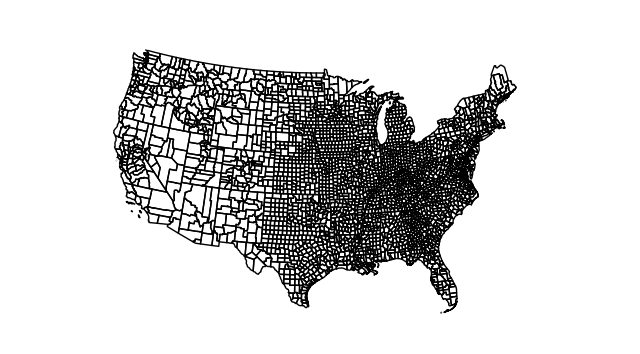

In [18]:
# Import the geopandas and geoplot libraries
import geopandas as gpd
import geoplot.crs as gcrs
import geoplot as gplt
import matplotlib.pyplot as plt

# Load the json file with county coordinates
geoData = gpd.read_file(
    'https://raw.githubusercontent.com/holtzy/The-Python-Graph-Gallery/master/static/data/US-counties.geojson'
)

# Make sure the "id" column is an integer
geoData.id = geoData['id'].astype(int)

# Remove Alaska, Hawaii and Puerto Rico.
statesToRemove = ['02', '15', '72']
geoData = geoData[~geoData.STATE.isin(statesToRemove)]

# Basic plot with just county outlines
gplt.polyplot(
    geoData,
    projection=gcrs.AlbersEqualArea()
)
plt.show()

In [19]:
geoData.head(10)

,id,GEO_ID,STATE,COUNTY,NAME,LSAD,CENSUSAREA,geometry
0,1001,0500000US01001,01,001,Autauga,County,594.436,"POLYGON ((-86.49677 32.34444, -86.7179 32.4028..."
1,1009,0500000US01009,01,009,Blount,County,644.776,"POLYGON ((-86.5778 33.76532, -86.75914 33.8406..."
2,1017,0500000US01017,01,017,Chambers,County,596.531,"POLYGON ((-85.18413 32.87052, -85.12342 32.772..."
3,1021,0500000US01021,01,021,Chilton,County,692.854,"POLYGON ((-86.51734 33.02057, -86.51596 32.929..."
4,1033,0500000US01033,01,033,Colbert,County,592.619,"POLYGON ((-88.13999 34.5817, -88.13925 34.5878..."
5,1045,0500000US01045,01,045,Dale,County,561.150,"POLYGON ((-85.41644 31.61947, -85.41743 31.314..."
6,1051,0500000US01051,01,051,Elmore,County,618.485,"POLYGON ((-86.33678 32.76747, -86.31948 32.753..."
7,1065,0500000US01065,01,065,Hale,County,643.943,"POLYGON ((-87.4212 32.87451, -87.47217 32.8306..."
8,1079,0500000US01079,01,079,Lawrence,County,690.678,"POLYGON ((-87.10507 34.68604, -87.10591 34.587..."
9,1083,0500000US01083,01,083,Limestone,County,559.936,"POLYGON ((-86.83631 34.99176, -86.82066 34.991..."


In [20]:
df_accidents_sample=df_accidents
df_accidents_sample.groupby("State").size().to_frame('size').sort_values(by='size', ascending=False).head(10)

,size
State,
CA,1741433
FL,880192
TX,582837
SC,382557
NY,347960
NC,338199
VA,303301
PA,296620
MN,192084


In [21]:
import geopandas
import pandas as pd
df_accidents_sample=df_accidents.sample(10000)
gdf = geopandas.GeoDataFrame(
    df_accidents_sample, geometry=geopandas.points_from_xy(df_accidents_sample.Start_Lng, df_accidents_sample.Start_Lat), crs="EPSG:4326"
)



Text(0.5, 1.0, 'Kings County Real Estate')

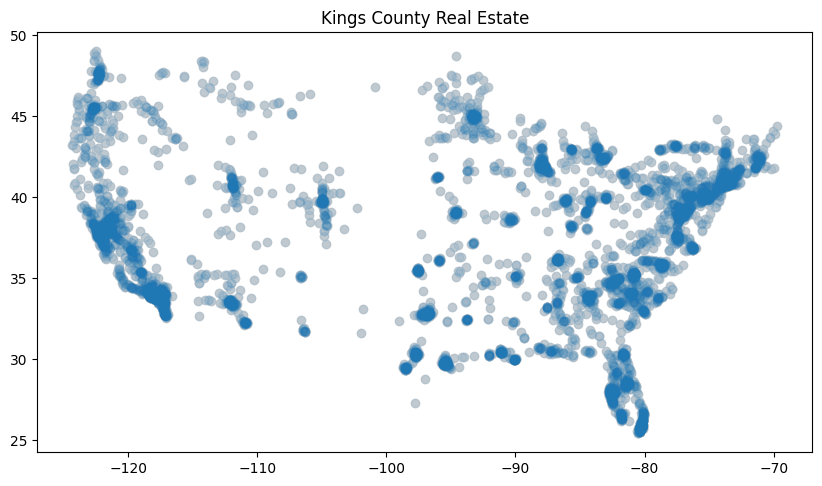

In [22]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize = (10,10))
gdf.to_crs(epsg=4326).plot(ax=ax, color='lightgrey')
gdf.plot(ax=ax, alpha = .1 )
ax.set_title('Kings County Real Estate')

In [25]:
import wget
wget.download("https://www2.census.gov/geo/tiger/GENZ2018/shp/cb_2018_us_state_500k.zip")
!unzip cb_2018_us_state_500k.zip -d cb_2018_us_state_500k

'unzip' n'est pas reconnu en tant que commande interne
ou externe, un programme ex�cutable ou un fichier de commandes.


In [26]:
import os
import geopandas as gpd
import plotly.figure_factory as ff
gdf = gpd.read_file('cb_2018_us_state_500k')
gdf.head()

,STATEFP,STATENS,AFFGEOID,GEOID,STUSPS,NAME,LSAD,ALAND,AWATER,geometry
0,28,01779790,0400000US28,28,MS,Mississippi,00,121533519481,3926919758,"MULTIPOLYGON (((-88.50297 30.21524, -88.49176 ..."
1,37,01027616,0400000US37,37,NC,North Carolina,00,125923656064,13466071395,"MULTIPOLYGON (((-75.72681 35.93584, -75.71827 ..."
2,40,01102857,0400000US40,40,OK,Oklahoma,00,177662925723,3374587997,"POLYGON ((-103.00256 36.52659, -103.00219 36.6..."
3,51,01779803,0400000US51,51,VA,Virginia,00,102257717110,8528531774,"MULTIPOLYGON (((-75.74241 37.80835, -75.74151 ..."
4,54,01779805,0400000US54,54,WV,West Virginia,00,62266474513,489028543,"POLYGON ((-82.6432 38.16909, -82.643 38.16956,..."


<Axes: >

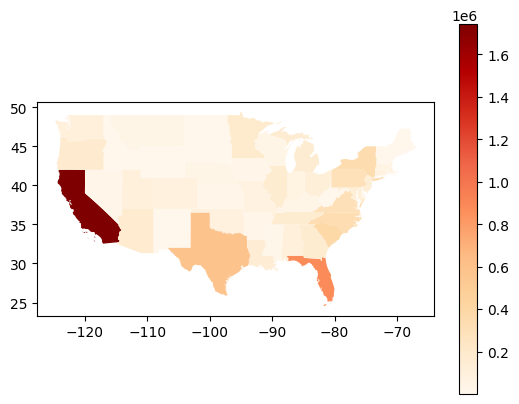

In [27]:
df_accidents_by_state=df_accidents.groupby("State").size().to_frame('size')
gdf_by_state = gdf.merge(df_accidents_by_state,left_on='STUSPS',right_on='State')
# For full list of colormaps : https://matplotlib.org/stable/users/explain/colors/colormaps.html
#cmap='cubehelix'
#cmap='Greens'
#cmap='winter'
cmap='OrRd'
gdf_by_state.plot(column='size', cmap=cmap, legend=True)

In [28]:
import plotly.graph_objects as go
fig = go.Figure(
    data=go.Choropleth(
        locations = pd.value_counts(df_accidents['State']).index,
        z = pd.value_counts(df_accidents['State']).values.astype(float),
        locationmode = 'USA-states',
        colorscale = 'SunsetDark',
        colorbar_title = "Count"),
    layout=go.Layout(
        title_text='US Accidents by State',
        title_x=0.5,
        font=dict(family='Verdana', size=12, color='#000000'),
        geo_scope='usa'))

fig.show()

C:\Users\lucas\AppData\Local\Temp\ipykernel_9880\3555798041.py:4: FutureWarning:

pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.

C:\Users\lucas\AppData\Local\Temp\ipykernel_9880\3555798041.py:5: FutureWarning:

pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.



In [29]:
pd.value_counts(df_accidents['State']).values.astype(float)

C:\Users\lucas\AppData\Local\Temp\ipykernel_9880\912714921.py:1: FutureWarning:

pandas.value_counts is deprecated and will be removed in a future version. Use pd.Series(obj).value_counts() instead.



array([1.741433e+06, 8.801920e+05, 5.828370e+05, 3.825570e+05,
       3.479600e+05, 3.381990e+05, 3.033010e+05, 2.966200e+05,
       1.920840e+05, 1.796600e+05, 1.706090e+05, 1.692340e+05,
       1.689580e+05, 1.673880e+05, 1.621910e+05, 1.497010e+05,
       1.407190e+05, 1.404170e+05, 1.181150e+05, 1.082210e+05,
       1.010440e+05, 9.707900e+04, 9.088500e+04, 8.364700e+04,
       7.732300e+04, 7.100500e+04, 6.722400e+04, 6.199600e+04,
       3.468800e+04, 3.225400e+04, 2.887000e+04, 2.849600e+04,
       2.630700e+04, 2.278000e+04, 2.166500e+04, 2.099200e+04,
       1.863000e+04, 1.697100e+04, 1.518100e+04, 1.409700e+04,
       1.379300e+04, 1.137600e+04, 1.032500e+04, 1.021300e+04,
       3.757000e+03, 3.487000e+03, 2.698000e+03, 9.260000e+02,
       2.890000e+02])

In [30]:
cmap = 'RdYlBu_r'

state_year_count = pd.pivot_table(df_accidents_sample, values='ID', index=['State'], columns=['Start_Year'], aggfunc='count').style.bar(cmap=cmap, axis=1)
state_year_count

Start_Year,2016,2017,2018,2019,2020,2021,2022,2023
State,,,,,,,,
AL,0,6,14,23,27,24,27,0
AR,0,0,1,1,6,9,15,0
AZ,7,16,28,40,39,29,49,12
CA,191,190,191,290,353,439,465,86
CO,1,7,24,26,19,23,35,6
CT,8,6,11,7,8,23,29,2
DC,0,1,1,4,4,10,9,0
DE,0,1,2,3,3,7,3,0
FL,48,77,97,76,168,319,318,27


In [31]:
cmap = 'RdYlBu_r'

#df_accidents_sample['Start_Year'].value_counts().to_frame().style.bar(cmap=cmap)
df_accidents_sample['State'].value_counts().to_frame().head(10).style.bar(cmap=cmap)

,count
State,
CA,2205
FL,1130
TX,771
SC,484
NY,478
NC,473
VA,399
PA,392
MN,250


In [ ]:
import folium
import math
from folium import Choropleth, Circle, Marker
from folium.plugins import HeatMap, MarkerCluster
# Create the map
map_usa = folium.Map(location=[37.498831, -97.667435], tiles='cartodbpositron', zoom_start=4)

# Add points to the map
mc = MarkerCluster()
for idx, row in df_accidents.sample(100000).iterrows():
    if not math.isnan(row['Start_Lat']) and not math.isnan(row['Start_Lng']):
        mc.add_child(Marker([row['Start_Lat'], row['Start_Lng']]))
map_usa.add_child(mc)

# Display the map
map_usa


[notice] A new release of pip is available: 24.2 -> 24.3.1
[notice] To update, run: C:\Users\lucas\AppData\Local\Microsoft\WindowsApps\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\python.exe -m pip install --upgrade pip


In [35]:
import re
import numpy as np
# show distinctive weather conditions
weather ='!'.join(df_accidents['Weather_Condition'].dropna().unique().tolist())
weather = np.unique(np.array(re.split(
    "!|\s/\s|\sand\s|\swith\s|Partly\s|Mostly\s|Blowing\s|Freezing\s", weather))).tolist()
print("Weather Conditions: ", weather)

df_accidents['Clear'] = np.where(df_accidents['Weather_Condition'].str.contains('Clear', case=False, na = False), True, False)
df_accidents['Cloud'] = np.where(df_accidents['Weather_Condition'].str.contains('Cloud|Overcast', case=False, na = False), True, False)
df_accidents['Rain'] = np.where(df_accidents['Weather_Condition'].str.contains('Rain|storm', case=False, na = False), True, False)
df_accidents['Heavy_Rain'] = np.where(df_accidents['Weather_Condition'].str.contains('Heavy Rain|Rain Shower|Heavy T-Storm|Heavy Thunderstorms', case=False, na = False), True, False)
df_accidents['Snow'] = np.where(df_accidents['Weather_Condition'].str.contains('Snow|Sleet|Ice', case=False, na = False), True, False)
df_accidents['Heavy_Snow'] = np.where(df_accidents['Weather_Condition'].str.contains('Heavy Snow|Heavy Sleet|Heavy Ice Pellets|Snow Showers|Squalls', case=False, na = False), True, False)
df_accidents['Fog'] = np.where(df_accidents['Weather_Condition'].str.contains('Fog', case=False, na = False), True, False)

Weather Conditions:  ['', 'Clear', 'Cloudy', 'Drifting Snow', 'Drizzle', 'Dust', 'Dust Whirls', 'Dust Whirls Nearby', 'Dust Whirlwinds', 'Duststorm', 'Fair', 'Fog', 'Funnel Cloud', 'Hail', 'Haze', 'Heavy ', 'Heavy Drizzle', 'Heavy Ice Pellets', 'Heavy Rain', 'Heavy Rain Shower', 'Heavy Rain Showers', 'Heavy Sleet', 'Heavy Smoke', 'Heavy Snow', 'Heavy T-Storm', 'Heavy Thunderstorms', 'Ice Pellets', 'Light ', 'Light Drizzle', 'Light Fog', 'Light Hail', 'Light Haze', 'Light Ice Pellets', 'Light Rain', 'Light Rain Shower', 'Light Rain Showers', 'Light Sleet', 'Light Snow', 'Light Snow Grains', 'Light Snow Shower', 'Light Snow Showers', 'Light Thunderstorm', 'Light Thunderstorms', 'Low Drifting Snow', 'Mist', 'N/A Precipitation', 'Overcast', 'Partial Fog', 'Patches of Fog', 'Rain', 'Rain Shower', 'Rain Showers', 'Sand', 'Scattered Clouds', 'Shallow Fog', 'Showers in the Vicinity', 'Sleet', 'Small Hail', 'Smoke', 'Snow', 'Snow Grains', 'Snow Nearby', 'Snow Showers', 'Squalls', 'T-Storm', 'Th

In [36]:
print(df_accidents.columns)
df_accidents_weather=df_accidents[['Temperature(F)','Wind_Chill(F)','Humidity(%)','Pressure(in)','Visibility(mi)','Wind_Speed(mph)','Precipitation(in)','Weather_Condition','Clear','Cloud','Rain','Heavy_Rain','Snow','Heavy_Snow','Fog']]
dummies = pd.get_dummies(df_accidents_weather['Weather_Condition'])

# concatenating the dummies DataFrame with the original DataFrame
#df_accidents_weather = pd.concat([df_accidents_weather, dummies], axis=1)
df_accidents_weather.drop(['Weather_Condition'], axis=1, inplace=True)
df_accidents_weather.head()

Index(['ID', 'Source', 'Severity', 'Start_Time', 'End_Time', 'Start_Lat',
       'Start_Lng', 'End_Lat', 'End_Lng', 'Distance(mi)', 'Description',
       'Street', 'City', 'County', 'State', 'Zipcode', 'Country', 'Timezone',
       'Airport_Code', 'Weather_Timestamp', 'Temperature(F)', 'Wind_Chill(F)',
       'Humidity(%)', 'Pressure(in)', 'Visibility(mi)', 'Wind_Direction',
       'Wind_Speed(mph)', 'Precipitation(in)', 'Weather_Condition', 'Amenity',
       'Bump', 'Crossing', 'Give_Way', 'Junction', 'No_Exit', 'Railway',
       'Roundabout', 'Station', 'Stop', 'Traffic_Calming', 'Traffic_Signal',
       'Turning_Loop', 'Sunrise_Sunset', 'Civil_Twilight', 'Nautical_Twilight',
       'Astronomical_Twilight', 'Start_Year', 'Clear', 'Cloud', 'Rain',
       'Heavy_Rain', 'Snow', 'Heavy_Snow', 'Fog'],
      dtype='object')


,Temperature(F),Wind_Chill(F),Humidity(%),Pressure(in),Visibility(mi),Wind_Speed(mph),Precipitation(in),Clear,Cloud,Rain,Heavy_Rain,Snow,Heavy_Snow,Fog
0,36.9,NaN,91.0,29.68,10.0,NaN,0.02,False,False,True,False,False,False,False
1,37.9,NaN,100.0,29.65,10.0,NaN,0.00,False,False,True,False,False,False,False
2,36.0,33.3,100.0,29.67,10.0,3.5,NaN,False,True,False,False,False,False,False
3,35.1,31.0,96.0,29.64,9.0,4.6,NaN,False,True,False,False,False,False,False
4,36.0,33.3,89.0,29.65,6.0,3.5,NaN,False,True,False,False,False,False,False


<Axes: >

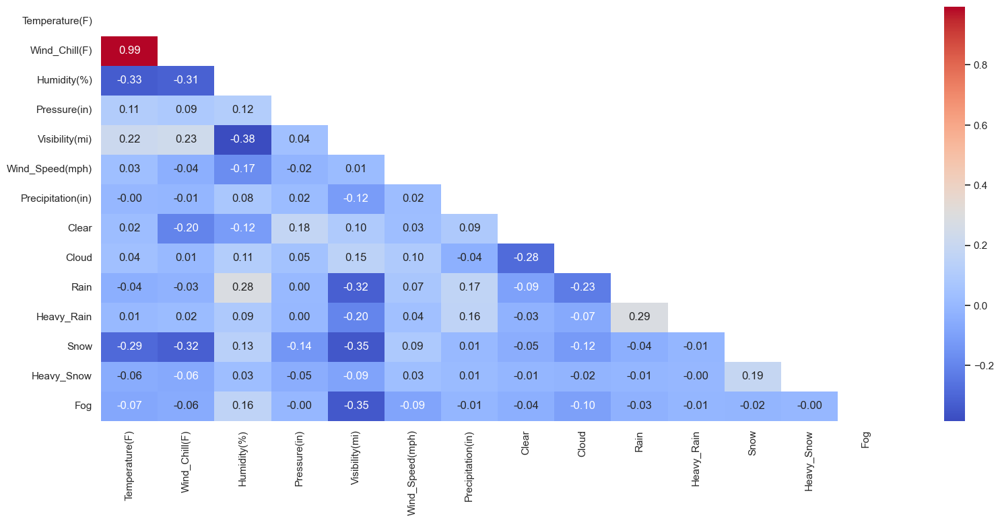

In [37]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np


plt.figure(figsize=(19, 8))
sns.set(style="white")
mask = np.triu(df_accidents_weather.corr())
sns.heatmap(data=df_accidents_weather.corr(), annot=True, fmt=".2f", cmap='coolwarm', mask=mask)

C:\Users\lucas\AppData\Local\Temp\ipykernel_9880\2459446646.py:17: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




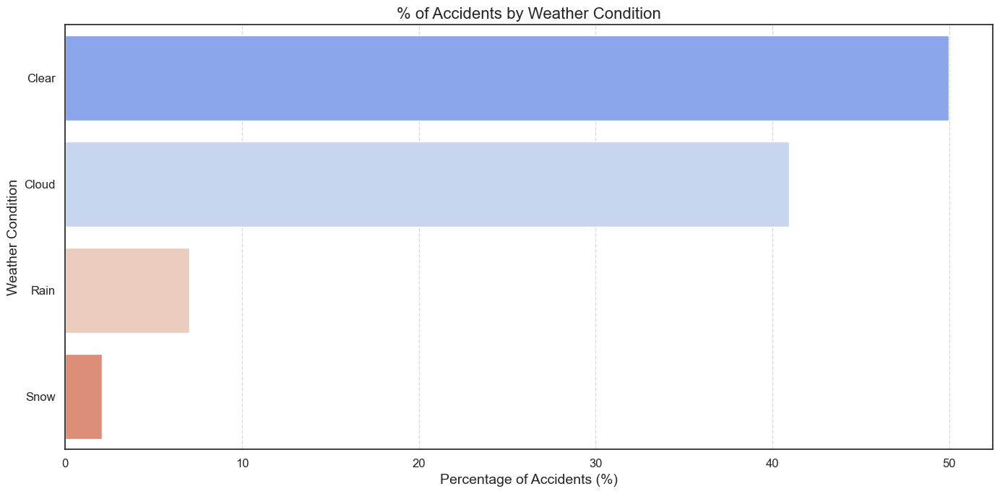

In [42]:
# Assuming df_accidents_weather is your dataset
# Replace 'Weather_Condition' with the actual column name for weather in your dataset
# Create a new column to summarize weather conditions
df_accidents_weather['Weather_Condition'] = df_accidents_weather[
    ['Clear', 'Cloud', 'Rain', 'Heavy_Rain', 'Snow']
].idxmax(axis=1)

# Calculate the percentage of accidents by weather condition
weather_accidents = df_accidents_weather['Weather_Condition'].value_counts(normalize=True) * 100

# Convert to a DataFrame for easier handling
weather_accidents_df = weather_accidents.reset_index()
weather_accidents_df.columns = ['Weather_Condition', 'Percentage']

# Plot the data
plt.figure(figsize=(14, 7))
sns.barplot(
    data=weather_accidents_df,
    x='Percentage',
    y='Weather_Condition',
    palette='coolwarm',
    order=weather_accidents_df.sort_values('Percentage', ascending=False)['Weather_Condition']
)
plt.title('% of Accidents by Weather Condition', fontsize=16)
plt.xlabel('Percentage of Accidents (%)', fontsize=14)
plt.ylabel('Weather Condition', fontsize=14)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

   Simplified_Weather  Severity    Count
0         Clear/Sunny         1      337
1         Clear/Sunny         2   536971
2         Clear/Sunny         3   244956
3         Clear/Sunny         4    26479
4              Cloudy         1    26065
5              Cloudy         2  2452646
6              Cloudy         3   601983
7              Cloudy         4    83056
8          Foggy/Hazy         1      704
9          Foggy/Hazy         2    93737
10         Foggy/Hazy         3    11242
11         Foggy/Hazy         4     2963
12              Other         1    36102
13              Other         2  2504881
14              Other         3   298647
15              Other         4    71549
16              Rainy         1     3679
17              Rainy         2   412308
18              Rainy         3   112113
19              Rainy         4    13857
20              Snowy         1      124
21              Snowy         2   129134
22              Snowy         3    26268
23              

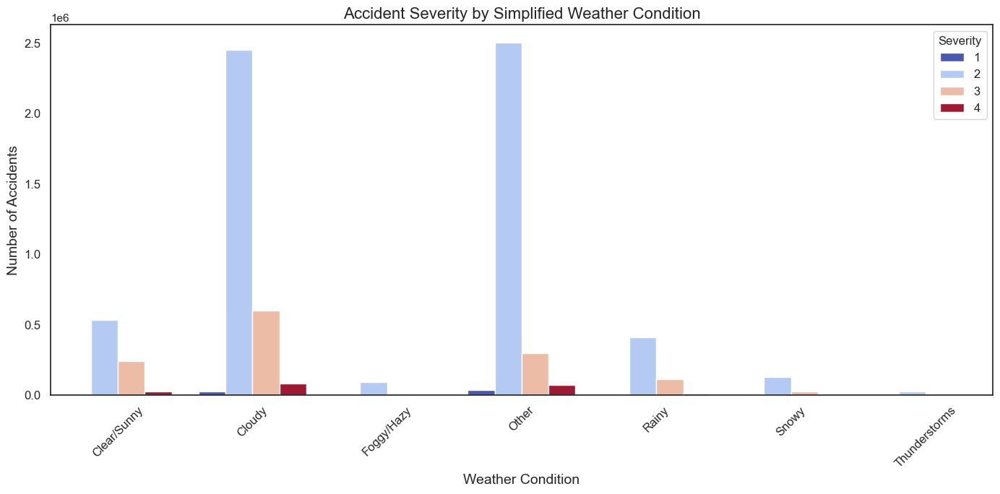

In [66]:
# Group by weather condition and severity to get the count of accidents
# Define a function to map weather conditions to broader categories
def categorize_weather(row):
    if row['Clear']:
        return 'Clear/Sunny'
    elif row['Cloud']:
        return 'Cloudy'
    elif row['Rain'] or row['Heavy_Rain'] or 'Rain' in str(row['Weather_Condition']):
        return 'Rainy'
    elif row['Snow'] or row['Heavy_Snow']:
        return 'Snowy'
    elif row['Fog']:
        return 'Foggy/Hazy'
    elif 'Thunder' in str(row['Weather_Condition']):
        return 'Thunderstorms'
    else:
        return 'Other'

# Apply the function to create a new column 'Simplified_Weather'
df_accidents['Simplified_Weather'] = df_accidents.apply(categorize_weather, axis=1)

print(severity_weather)

# Group by the simplified weather condition and severity to get the count of accidents
severity_weather = df_accidents.groupby(['Simplified_Weather', 'Severity']).size().reset_index(name='Count')

# Plot the data
plt.figure(figsize=(14, 7))
sns.barplot(
    data=severity_weather,
    x='Simplified_Weather',
    y='Count',
    hue='Severity',  # Differentiate by severity
    palette='coolwarm'
)

plt.title('Accident Severity by Simplified Weather Condition', fontsize=16)
plt.xlabel('Weather Condition', fontsize=14)
plt.ylabel('Number of Accidents', fontsize=14)
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.legend(title='Severity', fontsize=12)
plt.tight_layout()
plt.show()

Index(['Percentage', 1, 2, 3, 4], dtype='object', name='Severity')
Severity   Percentage         1          2          3         4
0         Clear/Sunny  0.041670  66.395752  30.288485  3.274093
1              Cloudy  0.823864  77.523382  19.027515  2.625239
2          Foggy/Hazy  0.647976  86.277452  10.347367  2.727206
3               Other  1.240116  86.043524  10.258627  2.457733
4               Rainy  0.678836  76.077622  20.686697  2.556845
  Simplified_Weather  Severity      Count
0        Clear/Sunny         1   0.041670
1        Clear/Sunny         2  66.395752
2        Clear/Sunny         3  30.288485
3        Clear/Sunny         4   3.274093
4             Cloudy         1   0.823864
5             Cloudy         2  77.523382
6             Cloudy         3  19.027515
7             Cloudy         4   2.625239
8         Foggy/Hazy         1   0.647976
9         Foggy/Hazy         2  86.277452
Severity     Percentage         1          2          3         4
0           Clear/Sun

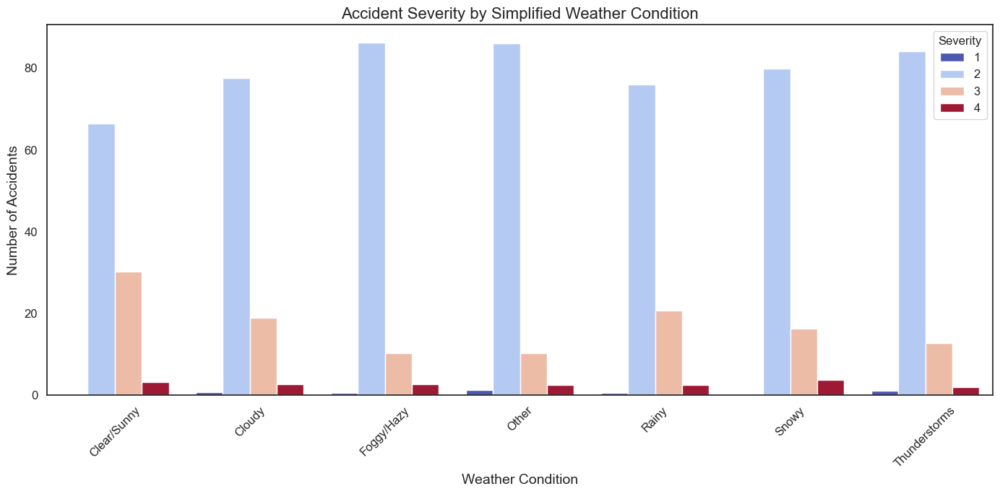

In [69]:
# Calculate the percentage of accidents by severity for each weather condition
severity_percentage = severity_weather.groupby('Simplified_Weather').apply(
    lambda group: group.set_index('Severity')['Count'] / group['Count'].sum() * 100
).reset_index(names=['Percentage'])

# Check the column names after the groupby operation
print(severity_percentage.columns)

print(severity_percentage.head())

reshaped_data = []

# Loop over the rows in the original table and transform it into the required format
for index, row in severity_percentage.iterrows():
    simplified_weather = row['Percentage']
    for severity in [1, 2, 3, 4]:
        count = row[severity]  # Access the count for each severity
        reshaped_data.append({
            'Simplified_Weather': simplified_weather,
            'Severity': severity,
            'Count': count
        })

# Convert the reshaped data into a DataFrame
reshaped_df = pd.DataFrame(reshaped_data)

# Check the reshaped DataFrame
print(reshaped_df.head(10))

# Check the reshaped data
print(severity_percentage.head(10))

# Plot the data
plt.figure(figsize=(14, 7))
sns.barplot(
    data=reshaped_df,
    x='Simplified_Weather',
    y='Count',
    hue='Severity',  # Differentiate by severity
    palette='coolwarm'
)

plt.title('Accident Severity by Simplified Weather Condition', fontsize=16)
plt.xlabel('Weather Condition', fontsize=14)
plt.ylabel('Number of Accidents', fontsize=14)
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)
plt.legend(title='Severity', fontsize=12)
plt.tight_layout()
plt.show()
